<h1>COVID-19 analysis and visualization using Plotly</h1>

The purpose of this side project was to practice data visualization with Plotly, as I had not used this library in my data analytic studies at JAMK. I focused my visualization on disease situation in Finland and Europe in particular. I got the idea from a data project article on the Geeksforgeeks website. Three csv files were used in the project.

**covid.csv** – This dataset contains Country/Region, Continent,  Population, TotalCases, NewCases, TotalDeaths, NewDeaths,  TotalRecovered, NewRecovered, ActiveCases, Serious, Critical, Tot Cases/1M pop, Deaths/1M pop, TotalTests, Tests/1M pop, WHO Region, iso_alpha.

**covid_grouped.csv** – This dataset contains Date(from 20-01-22 to 20-07-27), Country/Region, Confirmed, Deaths, Recovered, Active, New cases, New deaths, New recovered, WHO Region, iso_alpha.

**coviddeath.csv** – This dataset contains real-world examples of a number of Covid-19 deaths and the reasons behind the deaths.

In [67]:
import plotly.graph_objs as go 
import plotly.io as pio
import plotly.express as px 
import pandas as pd 
  
# Data Visualization 
import matplotlib.pyplot as plt 
  
# Importing Plotly 
import plotly.offline as py 
py.init_notebook_mode(connected=True) 
  
# Initializing Plotly 
pio.renderers.default = 'plotly_mimetype+notebook'

# Importing Dataset1 
dataset1 = pd.read_csv(r"C:\Users\taavi\OneDrive\Tiedostot\Jamk-opinnot\covid19-analysis-plotly\covid.csv") 
dataset1.head()  # returns first 5 rows 

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
0,USA,North America,3.311981e+08,5032179,NaN,162804.0,NaN,2576668.0,NaN,2292707.0,18296.0,15194.0,492.0,63139605.0,190640.0,Americas,USA
1,Brazil,South America,2.127107e+08,2917562,NaN,98644.0,NaN,2047660.0,NaN,771258.0,8318.0,13716.0,464.0,13206188.0,62085.0,Americas,BRA
2,India,Asia,1.381345e+09,2025409,NaN,41638.0,NaN,1377384.0,NaN,606387.0,8944.0,1466.0,30.0,22149351.0,16035.0,South-EastAsia,IND
3,Russia,Europe,1.459409e+08,871894,NaN,14606.0,NaN,676357.0,NaN,180931.0,2300.0,5974.0,100.0,29716907.0,203623.0,Europe,RUS
4,South Africa,Africa,5.938157e+07,538184,NaN,9604.0,NaN,387316.0,NaN,141264.0,539.0,9063.0,162.0,3149807.0,53044.0,Africa,ZAF


In [68]:
# Returns tuple of shape (Rows, columns)
print(dataset1.shape) 
  
# Returns size of dataframe 
print(dataset1.size) 

# Information about Dataset1 
# return concise summary of dataframe 
dataset1.info()   

(209, 17)
3553
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Country/Region    209 non-null    object 
 1   Continent         208 non-null    object 
 2   Population        208 non-null    float64
 3   TotalCases        209 non-null    int64  
 4   NewCases          4 non-null      float64
 5   TotalDeaths       188 non-null    float64
 6   NewDeaths         3 non-null      float64
 7   TotalRecovered    205 non-null    float64
 8   NewRecovered      3 non-null      float64
 9   ActiveCases       205 non-null    float64
 10  Serious,Critical  122 non-null    float64
 11  Tot Cases/1M pop  208 non-null    float64
 12  Deaths/1M pop     187 non-null    float64
 13  TotalTests        191 non-null    float64
 14  Tests/1M pop      191 non-null    float64
 15  WHO Region        184 non-null    object 
 16  iso_alpha         209 non-nul

In [69]:
# Importing Dataset2 
dataset2 = pd.read_csv(r"C:\Users\taavi\OneDrive\Tiedostot\Jamk-opinnot\covid19-analysis-plotly\covid_grouped.csv") 
dataset2.head()  # return first 5 rows of dataset2 


,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,AFG
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,ALB
2,2020-01-22,Algeria,0,0,0,0,0,0,0,Africa,DZA
3,2020-01-22,Andorra,0,0,0,0,0,0,0,Europe,AND
4,2020-01-22,Angola,0,0,0,0,0,0,0,Africa,AGO


In [70]:
# Returns tuple of shape (Rows, columns) 
print(dataset2.shape) 
  
# Returns size of dataframe 
print(dataset2.size)

# Information about Dataset2 
dataset2.info()  # return concise summary of dataframe 

(35156, 11)
386716
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Date            35156 non-null  object
 1   Country/Region  35156 non-null  object
 2   Confirmed       35156 non-null  int64 
 3   Deaths          35156 non-null  int64 
 4   Recovered       35156 non-null  int64 
 5   Active          35156 non-null  int64 
 6   New cases       35156 non-null  int64 
 7   New deaths      35156 non-null  int64 
 8   New recovered   35156 non-null  int64 
 9   WHO Region      35156 non-null  object
 10  iso_alpha       35156 non-null  object
dtypes: int64(7), object(4)
memory usage: 3.0+ MB


In [71]:
# Columns labels of a Dataset1 
dataset1.columns 

Index(['Country/Region', 'Continent', 'Population', 'TotalCases', 'NewCases',
       'TotalDeaths', 'NewDeaths', 'TotalRecovered', 'NewRecovered',
       'ActiveCases', 'Serious,Critical', 'Tot Cases/1M pop', 'Deaths/1M pop',
       'TotalTests', 'Tests/1M pop', 'WHO Region', 'iso_alpha'],
      dtype='object')

In [72]:
# Drop NewCases, NewDeaths, NewRecovered rows from dataset1 
  
dataset1.drop(['NewCases', 'NewDeaths', 'NewRecovered'],  
              axis=1, inplace=True) 
  
# Select random set of values from dataset1 
dataset1.sample(5) 

,Country/Region,Continent,Population,TotalCases,TotalDeaths,TotalRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
149,Chad,Africa,16467965.0,942,76.0,838.0,28.0,NaN,57.0,5.0,NaN,NaN,Africa,TCD
204,Montserrat,North America,4992.0,13,1.0,10.0,2.0,NaN,2604.0,200.0,61.0,12220.0,NaN,MSR
171,Martinique,North America,375235.0,276,15.0,98.0,163.0,1.0,736.0,40.0,12227.0,32585.0,NaN,MTQ
123,Estonia,Europe,1326627.0,2124,63.0,1954.0,107.0,NaN,1601.0,47.0,122880.0,92626.0,Europe,EST
37,Belarus,Europe,9449001.0,68503,580.0,63756.0,4167.0,NaN,7250.0,61.0,1344303.0,142269.0,Europe,BLR


In [7]:
# Import create_table Figure Factory 
  
from plotly.figure_factory import create_table 
  
colorscale = [[0, '#4d004c'], [.5, '#f2e5ff'], [1, '#ffffff']] 
table = create_table(dataset1.head(15), colorscale=colorscale) 
py.iplot(table) 

In [8]:
px.bar(dataset1.head(15), x = 'Country/Region',  
       y = 'TotalCases',color = 'TotalCases',  
       height = 500,hover_data = ['Country/Region', 'Continent'])

In [9]:
px.bar(dataset1.head(15), x = 'Country/Region', y = 'TotalCases', 
       color = 'TotalDeaths', height = 500, 
       hover_data = ['Country/Region', 'Continent'])

In [10]:
px.bar(dataset1.head(15), x = 'TotalTests', y = 'Country/Region', 
       color = 'TotalTests',orientation ='h',  height = 500, 
       hover_data = ['Country/Region', 'Continent'])

In [11]:
px.bar(dataset1.head(15), x = 'TotalTests', y = 'Continent', 
       color = 'TotalTests',orientation ='h',  height = 500, 
       hover_data = ['Country/Region', 'Continent'])

In [12]:
px.scatter(dataset1.head(57), x='Continent',y='TotalCases',  
           hover_data=['Country/Region', 'Continent'],  
           color='TotalCases', size='TotalCases', size_max=80, log_y=True)

In [15]:
px.scatter(dataset1.head(50), x='Continent',y='TotalTests', 
		hover_data=['Country/Region', 'Continent'], 
		color='TotalTests', size='TotalTests', size_max=80, log_y=True)


In [17]:
px.scatter(dataset1.head(100), x='Country/Region', y='TotalCases', 
		hover_data=['Country/Region', 'Continent'], 
		color='TotalCases', size='TotalCases', size_max=80)


In [18]:
px.scatter(dataset1.head(30), x='Country/Region', y='TotalCases',  
           hover_data=['Country/Region', 'Continent'], 
           color='Country/Region', size='TotalCases', size_max=80, log_y=True)

In [19]:
px.scatter(dataset1.head(10), x='Country/Region', y= 'TotalDeaths',  
           hover_data=['Country/Region', 'Continent'], 
           color='Country/Region', size= 'TotalDeaths', size_max=80)

In [20]:
px.scatter(dataset1.head(30), x='Country/Region', y= 'Tests/1M pop',  
           hover_data=['Country/Region', 'Continent'], 
           color='Country/Region', size= 'Tests/1M pop', size_max=80)

In [21]:
px.bar(dataset2, x="Date", y="Confirmed", color="Confirmed", 
	hover_data=["Confirmed", "Date", "Country/Region"], height=400)


In [22]:
px.bar(dataset2, x="Date", y="Confirmed", color="Confirmed", 
	hover_data=["Confirmed", "Date", "Country/Region"],log_y=True, height=400)


In [23]:
px.bar(dataset2, x="Date", y="Deaths", color="Deaths",  
       hover_data=["Confirmed", "Date", "Country/Region"], 
       log_y=False, height=400)

In [44]:
data_FIN = dataset2.loc[dataset2['Country/Region'] == 'Finland', ]
data_FIN.head()

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
60,2020-01-22,Finland,0,0,0,0,0,0,0,Europe,FIN
247,2020-01-23,Finland,0,0,0,0,0,0,0,Europe,FIN
434,2020-01-24,Finland,0,0,0,0,0,0,0,Europe,FIN
621,2020-01-25,Finland,0,0,0,0,0,0,0,Europe,FIN
808,2020-01-26,Finland,0,0,0,0,0,0,0,Europe,FIN


In [45]:
px.bar(data_FIN, x="Date", y="Confirmed", color="Confirmed", height=400)

In [46]:
px.bar(data_FIN,x="Date", y="Recovered", color="Recovered", height=400)


In [47]:
px.line(data_FIN,x="Date", y="Recovered", height=400)

In [48]:

px.line(data_FIN,x="Date", y="Deaths", height=400)

In [49]:

px.line(data_FIN,x="Date", y="Confirmed", height=400)

In [50]:
px.line(data_FIN,x="Date", y="New cases", height=400)

In [35]:

px.bar(data_FIN,x="Date", y="New cases", height=400)

In [51]:
px.scatter(data_FIN, x="Confirmed", y="Deaths", height=400)

In [54]:

data_EU = dataset2.loc[dataset2['WHO Region'] == 'Europe']

fig = px.choropleth(data_EU, 
                    locations='iso_alpha', 
                    color="Confirmed", 
                    hover_name="Country/Region", 
                    color_continuous_scale="Reds", 
                    animation_frame="Date",
                    range_color=(0, data_EU["Confirmed"].max()))


fig.update_geos(
    projection_scale=2,
    scope="europe"
)

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 50
fig.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 0

fig.show()


In [55]:
fig = px.choropleth(data_EU, 
                    locations='iso_alpha', 
                    color="Deaths", 
                    hover_name="Country/Region", 
                    color_continuous_scale="Reds", 
                    animation_frame="Date",
                    range_color=(0, data_EU["Deaths"].max()))


fig.update_geos(
    projection_scale=2,
    scope="europe"
)

fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 50
fig.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 0

fig.show()

In [56]:
fig2 = px.bar(data_EU, x="Country/Region", y="Confirmed", color="Country/Region",  
       animation_frame="Date", hover_name="Country/Region", range_color=(0, data_EU["Confirmed"].max()))

fig2.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 100
fig2.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 0

fig2.update_layout(
    height=900,
    width=1200,
    xaxis=dict(tickangle=-45)
)

fig2.show()




In [57]:
dataset3= pd.read_csv(r"C:\Users\taavi\OneDrive\Tiedostot\Jamk-opinnot\covid19-analysis-plotly\coviddeath.csv") 
dataset3.head()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
0,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,0-24,122.0,NaN
1,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,25-34,596.0,NaN
2,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,35-44,1521.0,NaN
3,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,45-54,4186.0,NaN
4,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,55-64,10014.0,NaN


In [58]:
dataset3.tail()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
12255,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,65-74,5024.0,NaN
12256,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,75-84,5381.0,NaN
12257,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,85+,4841.0,NaN
12258,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,Not stated,NaN,Counts less than 10 suppressed.
12259,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,All ages,20628.0,NaN


In [60]:
dataset3.groupby(["Condition"]).count()

,Data as of,Start Week,End Week,State,Condition Group,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
Condition,,,,,,,,,
Adult respiratory distress syndrome,540,540,540,540,540,540,540,272,268
All other conditions and causes (residual),540,540,540,540,540,540,540,363,177
Alzheimer disease,530,530,530,530,530,530,530,144,386
COVID-19,540,540,540,540,540,540,540,377,163
Cardiac arrest,520,520,520,520,520,520,520,219,301
Cardiac arrhythmia,540,540,540,540,540,540,540,192,348
Cerebrovascular diseases,530,530,530,530,530,530,530,187,343
Chronic lower respiratory diseases,540,540,540,540,540,540,540,229,311
Diabetes,540,540,540,540,540,540,540,276,264


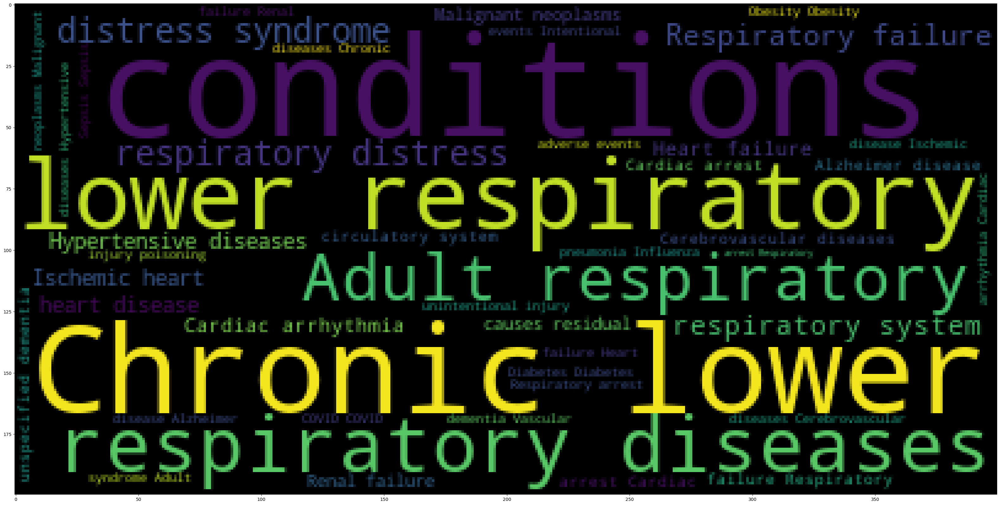

In [63]:
# import word cloud 
from wordcloud import WordCloud 
  
sentences = dataset3["Condition"].tolist() 
sentences_as_a_string = ' '.join(sentences) 
  
  
# Convert the string into WordCloud 
plt.figure(figsize=(40, 40)) 
plt.imshow(WordCloud().generate(sentences_as_a_string))

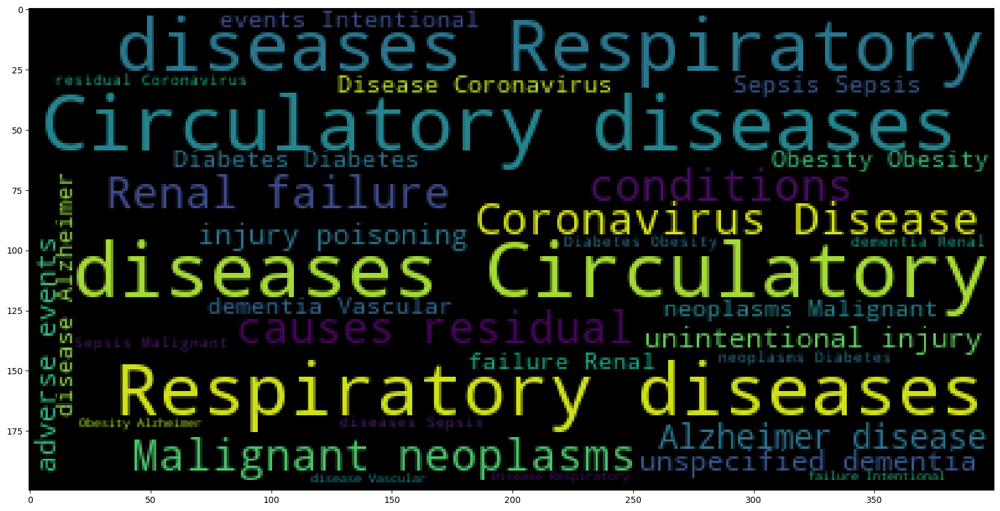

In [64]:
column2_tolist= dataset3["Condition Group"].tolist() 
  
# Convert the list to one single string 
column_to_string= " ".join(column2_tolist) 
  
# Convert the string into WordCloud 
plt.figure(figsize=(20,20)) 
plt.imshow(WordCloud().generate(column_to_string))